In [1]:
from sklearn import preprocessing
import pandas as pd
import numpy as np
from sklearn import tree
import matplotlib.pyplot as plt
from datetime import datetime
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy import stats


df_per= pd.read_excel("C:/Users/57314/Documents/LEONARDO/CAR/CAR 2023/CIENCIA DE DATOS DLIA/DATOS RAMCA/Periodo 1 B. peristaltica.xlsx")
df_dia= pd.read_excel("C:/Users/57314/Documents/LEONARDO/CAR/CAR 2023/CIENCIA DE DATOS DLIA/DATOS RAMCA/Periodo 2. B diafragma.xlsx")


## Bomba peristaltica

In [2]:
len(df_per)

6828

In [3]:
df_per

,DateTime,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Velocidad [m/s],Temp [°C],Pluviometro [mm/min]
0,2023-04-01 00:00:00,7.18,407.24,0.02,60.91,203.60,18.52,30.82,62.33,209.36,231.76,0.0,16.79,0.0
1,2023-04-01 00:05:00,7.18,409.09,0.02,60.91,202.01,18.57,30.90,62.82,210.93,231.35,0.0,16.79,0.0
2,2023-04-01 00:10:00,7.18,406.30,0.02,60.98,195.81,18.56,31.06,61.50,211.58,231.73,0.0,16.79,0.0
3,2023-04-01 00:15:00,7.18,407.02,0.03,61.03,196.10,18.59,31.11,62.27,210.63,234.00,0.0,16.83,0.0
4,2023-04-01 00:20:00,7.18,407.50,0.03,59.56,189.76,18.57,31.17,60.86,210.52,231.31,0.0,16.86,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6823,2023-04-27 23:35:00,7.13,428.59,0.03,91.46,142.42,19.29,35.65,71.02,0.00,217.88,0.0,16.75,0.0
6824,2023-04-27 23:40:00,7.13,432.81,0.03,91.46,144.14,19.20,35.59,73.61,13831.00,218.72,0.0,16.74,0.0
6825,2023-04-27 23:45:00,7.13,431.19,0.03,90.96,145.33,19.20,35.59,75.81,8855.59,218.68,0.0,16.75,0.0
6826,2023-04-27 23:50:00,7.14,427.31,0.03,89.03,144.92,19.20,35.59,78.02,5822.36,218.75,0.0,16.74,0.0


In [4]:
df_per.describe()

,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Velocidad [m/s],Temp [°C],Pluviometro [mm/min]
count,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6623.000000,6179.000000,6623.000000,6270.000000
mean,7.238013,409.282547,0.307146,54.201173,180.597217,19.470846,35.414780,154.433763,203.098597,205.918129,0.007589,18.969644,0.008134
std,0.198663,77.907842,1.043050,70.671662,43.138461,5.967620,6.291105,130.766617,385.121090,29.734286,0.051289,2.222191,0.134011
min,0.000000,0.000000,0.000000,0.000000,90.800000,2.290000,3.160000,26.270000,0.000000,159.090000,0.000000,0.000000,0.000000
25%,7.160000,356.485000,0.020000,18.545000,154.715000,14.390000,31.510000,55.720000,76.935000,181.645000,0.000000,17.390000,0.000000
50%,7.240000,419.150000,0.030000,38.400000,170.980000,17.990000,35.380000,109.560000,153.410000,200.150000,0.000000,18.570000,0.000000
75%,7.350000,448.895000,0.030000,60.975000,187.300000,24.765000,39.760000,216.645000,205.740000,217.490000,0.000000,20.520000,0.000000
max,7.910000,1331.600000,7.130000,2842.860000,534.690000,65.710000,51.080000,674.490000,13831.000000,486.800000,0.550000,25.080000,6.000000


In [5]:
df_per.dtypes

DateTime                datetime64[ns]
pH [pH]                        float64
X [uS/cm]                      float64
O2 [mg/l]                      float64
TUR [NTU]                      float64
NO3 [mg/l]                     float64
NH4 [mg/l]                     float64
K [mg/l]                       float64
Cloruros [mg/L]                float64
Solidos [mg/L]                 float64
Nivel [cm]                     float64
Velocidad [m/s]                float64
Temp [°C]                      float64
Pluviometro [mm/min]           float64
dtype: object

In [6]:
# Contar Nulos
null_count = df_per.isnull().sum(axis=0)
# Imprimimos el resultado
print(null_count)

DateTime                  0
pH [pH]                 205
X [uS/cm]               205
O2 [mg/l]               205
TUR [NTU]               205
NO3 [mg/l]              205
NH4 [mg/l]              205
K [mg/l]                205
Cloruros [mg/L]         205
Solidos [mg/L]          205
Nivel [cm]              205
Velocidad [m/s]         649
Temp [°C]               205
Pluviometro [mm/min]    558
dtype: int64


<AxesSubplot:>

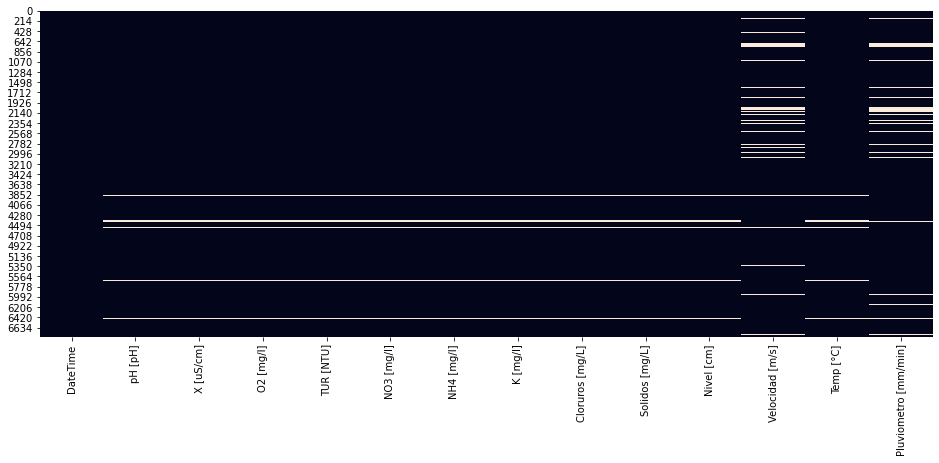

In [7]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_per.isnull(), cbar=False)

In [8]:
df_per["Pluviometro [mm/min]"].value_counts(dropna=False).head(3)

0.0    6235
NaN     558
1.0      27
Name: Pluviometro [mm/min], dtype: int64

In [9]:
df_per["Velocidad [m/s]"].value_counts(dropna=False).head(3)

0.00    6033
NaN      649
0.32       7
Name: Velocidad [m/s], dtype: int64

In [10]:
columnas_eliminar = ["Velocidad [m/s]", "Pluviometro [mm/min]"]
df_per = df_per.drop(columnas_eliminar, axis=1)

In [11]:
# Eliminamos las filas con missing Values, se elimina todos los las filas NAN son las mismas en todas las columnas 
df_per.dropna(subset=['pH [pH]'], inplace=True)

<AxesSubplot:>

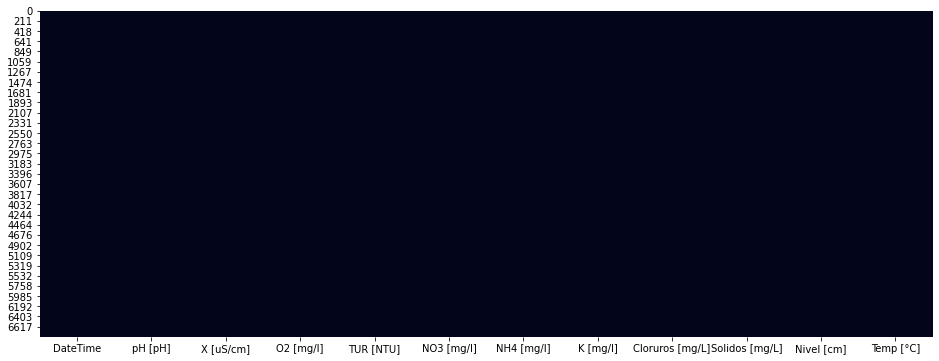

In [12]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_per.isnull(), cbar=False)

In [13]:
df_per.reset_index(drop=True, inplace=True)

<ipython-input-14-f048e6dcffe6>:3: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(df_per.corr(), dtype=np.bool))


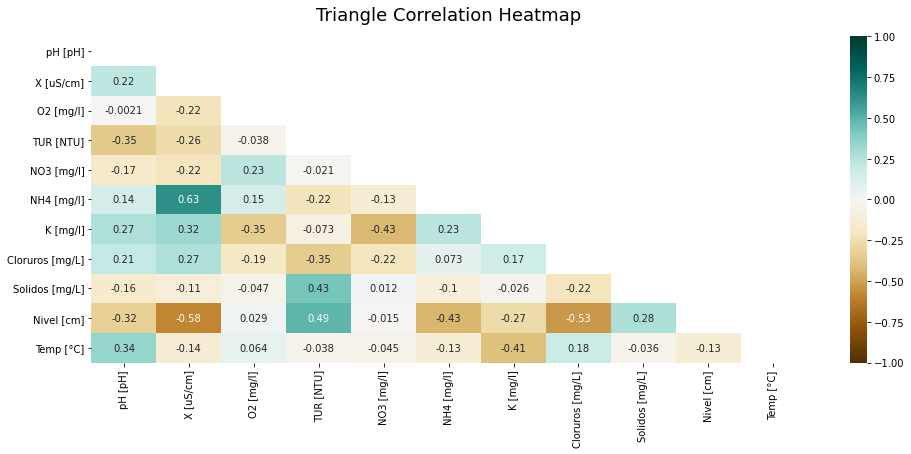

In [14]:
plt.figure(figsize=(16, 6))
# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(df_per.corr(), dtype=np.bool))
heatmap = sns.heatmap(df_per.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

In [47]:
df_per

,DateTime,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
0,2023-04-01 00:00:00,7.18,407.24,0.02,60.91,203.60,18.52,30.82,62.33,209.36,231.76,16.79
1,2023-04-01 00:05:00,7.18,409.09,0.02,60.91,202.01,18.57,30.90,62.82,210.93,231.35,16.79
2,2023-04-01 00:10:00,7.18,406.30,0.02,60.98,195.81,18.56,31.06,61.50,211.58,231.73,16.79
3,2023-04-01 00:15:00,7.18,407.02,0.03,61.03,196.10,18.59,31.11,62.27,210.63,234.00,16.83
4,2023-04-01 00:20:00,7.18,407.50,0.03,59.56,189.76,18.57,31.17,60.86,210.52,231.31,16.86
...,...,...,...,...,...,...,...,...,...,...,...,...
6618,2023-04-27 23:35:00,7.13,428.59,0.03,91.46,142.42,19.29,35.65,71.02,0.00,217.88,16.75
6619,2023-04-27 23:40:00,7.13,432.81,0.03,91.46,144.14,19.20,35.59,73.61,13831.00,218.72,16.74
6620,2023-04-27 23:45:00,7.13,431.19,0.03,90.96,145.33,19.20,35.59,75.81,8855.59,218.68,16.75
6621,2023-04-27 23:50:00,7.14,427.31,0.03,89.03,144.92,19.20,35.59,78.02,5822.36,218.75,16.74


## Kmeans


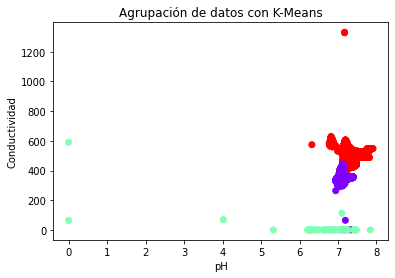

In [77]:
from sklearn.cluster import KMeans

# Selecciona las columnas relevantes para la agrupación
selected_columns = ['pH_pH', 'X_uS/cm', 'O2_mg/l', 'TUR_NTU', 'NO3_mg/l', 'NH4_mg/l', 'K_mg/l', 'Cloruros_mg/L', 'Solidos_mg/L', 'Nivel_cm', 'Temp_°C']
X = df_per[selected_columns]

X_normalized = (X - X.mean()) / X.std()

# Elige el número de clústeres (grupos) que deseas encontrar
num_clusters = 3

# Crea una instancia del modelo K-Means
kmeans = KMeans(n_clusters=num_clusters)

# Ajusta el modelo a tus datos
kmeans.fit(X_normalized)

# Agrega las etiquetas de clúster a tus datos originales
df_per['cluster_label'] = kmeans.labels_

# Plotea el resultado de la agrupación para las dos primeras características
plt.scatter(X['pH_pH'], X['X_uS/cm'], c=df_per['cluster_label'], cmap='rainbow')
plt.xlabel('pH')
plt.ylabel('Conductividad')
plt.title('Agrupación de datos con K-Means')
plt.show()

,DateTime,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C,cluster_label
0,2023-04-01 00:00:00,7.18,407.24,0.02,60.91,203.60,18.52,30.82,62.33,209.36,231.76,16.79,1
1,2023-04-01 00:05:00,7.18,409.09,0.02,60.91,202.01,18.57,30.90,62.82,210.93,231.35,16.79,1
2,2023-04-01 00:10:00,7.18,406.30,0.02,60.98,195.81,18.56,31.06,61.50,211.58,231.73,16.79,1
3,2023-04-01 00:15:00,7.18,407.02,0.03,61.03,196.10,18.59,31.11,62.27,210.63,234.00,16.83,1
4,2023-04-01 00:20:00,7.18,407.50,0.03,59.56,189.76,18.57,31.17,60.86,210.52,231.31,16.86,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6618,2023-04-27 23:35:00,7.13,428.59,0.03,91.46,142.42,19.29,35.65,71.02,0.00,217.88,16.75,1
6619,2023-04-27 23:40:00,7.13,432.81,0.03,91.46,144.14,19.20,35.59,73.61,13831.00,218.72,16.74,1
6620,2023-04-27 23:45:00,7.13,431.19,0.03,90.96,145.33,19.20,35.59,75.81,8855.59,218.68,16.75,1
6621,2023-04-27 23:50:00,7.14,427.31,0.03,89.03,144.92,19.20,35.59,78.02,5822.36,218.75,16.74,1


In [81]:
for i in range(1):
    # Crear la figura con subplots
    fig = make_subplots(rows=2, cols=1)

    # Agregar el primer gráfico de líneas en el primer subplot
    fig.add_trace(go.Line(x=df_per['DateTime'], y=df_per[columns[i]],mode='markers', name = "Sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico de líneas en el segundo subplot
    fig.add_trace(go.Line(x=globals()[dataframe_names[i]].iloc[:, 1], y=globals()[dataframe_names[i]].iloc[:, 0], mode='markers',name = "Con limpieza"), row=2, col=1)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(height=500, width=1000, title_text="Gráficas de violín de " + columns[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    

In [90]:
for i in range(1):
    # Crear la figura con subplots
    fig = make_subplots(rows=2, cols=1)

    # Agregar el primer gráfico de líneas en el primer subplot
    fig.add_trace(go.Scatter(x=df_per['DateTime'], y=df_per[columns[i]], mode='markers', marker=dict(color=df_per['cluster_label']), name="Sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico de líneas en el segundo subplot
    fig.add_trace(go.Scatter(x=globals()[dataframe_names[i]].iloc[:, 1], y=globals()[dataframe_names[i]].iloc[:, 0], mode='markers', marker=dict(color=df_per['cluster_label']), name="Con limpieza"), row=2, col=1)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(height=500, width=1000, title_text="Gráficas de violín de " + columns[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    

In [15]:
columns = list(df_per.columns)
columns = columns[1:]

In [16]:
columns_sin_espacios = list()
for i in range(0,len(columns)):
    columnSinEspacios = columns[i].replace(" ", "")
    columnSinEspacios = columnSinEspacios.replace("[", "_")
    columnSinEspacios = columnSinEspacios.replace("]", "")
    columns_sin_espacios.append(columnSinEspacios)

In [17]:
for i in range(0,len(columns)):
    df_per = df_per.rename(columns={columns[i]: columns_sin_espacios[i]})

# Cambiar los nombres para el manejo de variables 

In [18]:
columns = list(df_per.columns)
columns = columns[1:]
columns

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

In [19]:
for column in columns:
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_per[column], name = "Violin"), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Histogram(x=df_per[column], nbinsx=100, name = "Histograma"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=950, height=400, title="Graficas de violin de "+ column +" para bomba peristaltica")

    # Mostrar la figura
    fig.show()


In [20]:
variables_z = list()
for column in columns:
    variable_name = "z_" + column
    globals()[variable_name] = np.abs(stats.zscore(df_per[column]))
    variables_z.append(variable_name)

In [21]:
variables_z

['z_pH_pH',
 'z_X_uS/cm',
 'z_O2_mg/l',
 'z_TUR_NTU',
 'z_NO3_mg/l',
 'z_NH4_mg/l',
 'z_K_mg/l',
 'z_Cloruros_mg/L',
 'z_Solidos_mg/L',
 'z_Nivel_cm',
 'z_Temp_°C']

In [22]:
z_pH_pH

array([0.29203907, 0.29203907, 0.29203907, ..., 0.54374055, 0.49340025,
       0.49340025])

In [23]:
variables_atipicos = list()
for i in range(0,len(columns)):
    variable_name = "atp_" + columns[i]
    globals()[variable_name] = (np.where(globals()[variables_z[i]] > 3))
    variables_atipicos.append(variable_name)
variables_atipicos

['atp_pH_pH',
 'atp_X_uS/cm',
 'atp_O2_mg/l',
 'atp_TUR_NTU',
 'atp_NO3_mg/l',
 'atp_NH4_mg/l',
 'atp_K_mg/l',
 'atp_Cloruros_mg/L',
 'atp_Solidos_mg/L',
 'atp_Nivel_cm',
 'atp_Temp_°C']

In [24]:
atp_pH_pH

(array([ 656,  657,  668,  669,  670,  671,  672,  673,  674,  675,  676,
         677,  678,  679,  680,  717,  718,  719,  720,  721,  722,  723,
         724,  725, 2702, 2703, 3837, 3838, 3839, 3840, 3841, 3842, 3843,
        3844, 3845, 4619, 4620], dtype=int64),)

In [71]:
dataframe_names = list()
# Crear los DataFrames y asignarles nombres de variables
for i in range(len(columns)):
    dataframe_name = f"df_sin_atp_{variables_atipicos[i]}"
    globals()[dataframe_name] = df_per[[columns[i],"DateTime","cluster_label"]].drop(index = globals()[variables_atipicos[i]][0])
    dataframe_names.append(dataframe_name)
dataframe_names

['df_sin_atp_atp_pH_pH',
 'df_sin_atp_atp_X_uS/cm',
 'df_sin_atp_atp_O2_mg/l',
 'df_sin_atp_atp_TUR_NTU',
 'df_sin_atp_atp_NO3_mg/l',
 'df_sin_atp_atp_NH4_mg/l',
 'df_sin_atp_atp_K_mg/l',
 'df_sin_atp_atp_Cloruros_mg/L',
 'df_sin_atp_atp_Solidos_mg/L',
 'df_sin_atp_atp_Nivel_cm',
 'df_sin_atp_atp_Temp_°C']

In [72]:
globals()[dataframe_names[1]]

,X_uS/cm,DateTime,cluster_label
0,407.24,2023-04-01 00:00:00,1
1,409.09,2023-04-01 00:05:00,1
2,406.30,2023-04-01 00:10:00,1
3,407.02,2023-04-01 00:15:00,1
4,407.50,2023-04-01 00:20:00,1
...,...,...,...
6618,428.59,2023-04-27 23:35:00,1
6619,432.81,2023-04-27 23:40:00,1
6620,431.19,2023-04-27 23:45:00,1
6621,427.31,2023-04-27 23:50:00,1


In [65]:
for i in range(len(columns)):
    globals()[dataframe_names[i]].reset_index(drop=True, inplace=True)

In [66]:
globals()[dataframe_names[1]].iloc[:, 0]

0       407.24
1       409.09
2       406.30
3       407.02
4       407.50
         ...  
6540    428.59
6541    432.81
6542    431.19
6543    427.31
6544    424.91
Name: X_uS/cm, Length: 6545, dtype: float64

# Comparacion diagrama de Bigotes - violin, con y sin datos atipicos

In [67]:
for i in range(len(columns)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_per[columns[i]], name = "sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Box(y=globals()[dataframe_names[i]].iloc[:, 0], name = "con limpieza"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Graficas de bigotes de " + columns[i] +" para bomba peristaltica")

    # Mostrar la figura
    fig.show()

In [70]:
import plotly.io as pio
for i in range(len(columns)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico (violin plot) en el primer subplot
    fig.add_trace(go.Violin(y=df_per[columns[i]], name="sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico (violin plot) en el segundo subplot
    fig.add_trace(go.Violin(y=globals()[dataframe_names[i]].iloc[:, 0], name="con limpieza"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Gráficas de violín de " + columns[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    
    #Guardar HTML
    #file_name = "graficas_violin_" + columns[i] + ".html"
    #pio.write_html(fig, file_name)

El valor de "kde" en el contexto de los diagramas de violín se refiere a la estimación de densidad del kernel (Kernel Density Estimation, KDE por sus siglas en inglés). El KDE es una técnica utilizada para estimar la función de densidad de probabilidad de un conjunto de datos. En el caso de los diagramas de violín, el KDE se utiliza para trazar una curva suave que muestra la estimación de la distribución de los datos.

# Serie de tiempo para PH 

In [73]:
for i in range(len(columns)):
    # Crear la figura con subplots
    fig = make_subplots(rows=2, cols=1)

    # Agregar el primer gráfico de líneas en el primer subplot
    fig.add_trace(go.Line(x=df_per['DateTime'], y=df_per[columns[i]], name = "Sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico de líneas en el segundo subplot
    fig.add_trace(go.Line(x=globals()[dataframe_names[i]].iloc[:, 1], y=globals()[dataframe_names[i]].iloc[:, 0], name = "Con limpieza"), row=2, col=1)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(height=500, width=1000, title_text="Gráficas de violín de " + columns[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    

C:\Users\57314\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




# Medias moviles

## Bomba Diafragma

In [32]:
len(df_dia)


753

In [33]:
df_dia

,DateTime,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Velocidad [m/s],Temp [°C],Pluviometro [mm/min]
0,2023-04-28 12:00:00,7.21,370.58,1.18,52.73,177.50,14.84,21.64,40.38,211.64,221.79,0.0,19.03,0.0
1,2023-04-28 12:05:00,7.19,367.68,0.90,51.57,171.44,15.01,22.76,38.99,208.63,222.69,0.0,18.76,0.0
2,2023-04-28 12:10:00,7.18,367.76,0.67,51.02,177.65,15.48,23.96,39.12,207.53,223.95,0.0,18.59,0.0
3,2023-04-28 12:15:00,7.17,368.73,0.53,50.13,177.01,15.64,24.54,37.61,206.22,227.40,0.0,18.46,0.0
4,2023-04-28 12:20:00,7.16,364.06,0.40,50.59,185.12,15.66,25.06,38.42,207.19,364.38,NaN,18.32,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
748,2023-05-01 05:40:00,7.12,359.81,0.03,55.47,134.15,18.21,41.12,55.85,214.39,420.48,0.0,16.90,0.0
749,2023-05-01 05:45:00,7.13,358.46,0.03,55.87,133.22,18.15,41.10,55.31,216.96,428.12,0.0,16.92,0.0
750,2023-05-01 05:50:00,7.13,360.80,0.03,55.81,134.26,18.10,41.22,55.75,216.18,413.43,0.0,16.92,0.0
751,2023-05-01 05:55:00,7.13,359.26,0.03,55.94,132.04,18.11,41.13,54.95,221.63,384.58,0.0,16.89,0.0


In [34]:
df_dia.describe()

,pH [pH],X [uS/cm],O2 [mg/l],TUR [NTU],NO3 [mg/l],NH4 [mg/l],K [mg/l],Cloruros [mg/L],Solidos [mg/L],Nivel [cm],Velocidad [m/s],Temp [°C],Pluviometro [mm/min]
count,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,738.000000,714.000000,738.000000,722.000000
mean,7.143577,383.426152,0.253374,47.631897,155.417019,17.615136,36.735908,50.251558,193.263225,399.098821,0.002899,17.814607,0.001385
std,0.018701,26.390884,0.350290,5.504834,24.487715,2.054834,3.954567,11.093091,19.815277,32.796839,0.026266,0.607605,0.037216
min,7.090000,332.920000,0.030000,37.460000,122.160000,13.680000,21.640000,35.130000,161.880000,221.790000,0.000000,16.670000,0.000000
25%,7.130000,363.017500,0.030000,43.215000,136.152500,16.335000,34.070000,41.670000,177.152500,384.597500,0.000000,17.360000,0.000000
50%,7.150000,381.855000,0.030000,47.870000,144.080000,18.235000,37.315000,48.380000,194.080000,406.280000,0.000000,17.665000,0.000000
75%,7.160000,403.130000,0.527500,51.135000,171.940000,18.897500,39.780000,56.687500,207.995000,421.542500,0.000000,18.310000,0.000000
max,7.210000,439.590000,1.330000,103.170000,214.000000,39.930000,73.060000,83.860000,389.680000,446.090000,0.290000,19.420000,1.000000


In [35]:
df_dia.dtypes

DateTime                datetime64[ns]
pH [pH]                        float64
X [uS/cm]                      float64
O2 [mg/l]                      float64
TUR [NTU]                      float64
NO3 [mg/l]                     float64
NH4 [mg/l]                     float64
K [mg/l]                       float64
Cloruros [mg/L]                float64
Solidos [mg/L]                 float64
Nivel [cm]                     float64
Velocidad [m/s]                float64
Temp [°C]                      float64
Pluviometro [mm/min]           float64
dtype: object

In [36]:
# Contar Nulos
null_count = df_dia.isnull().sum(axis=0)
# Imprimimos el resultado
print(null_count)

DateTime                 0
pH [pH]                 15
X [uS/cm]               15
O2 [mg/l]               15
TUR [NTU]               15
NO3 [mg/l]              15
NH4 [mg/l]              15
K [mg/l]                15
Cloruros [mg/L]         15
Solidos [mg/L]          15
Nivel [cm]              15
Velocidad [m/s]         39
Temp [°C]               15
Pluviometro [mm/min]    31
dtype: int64


<AxesSubplot:>

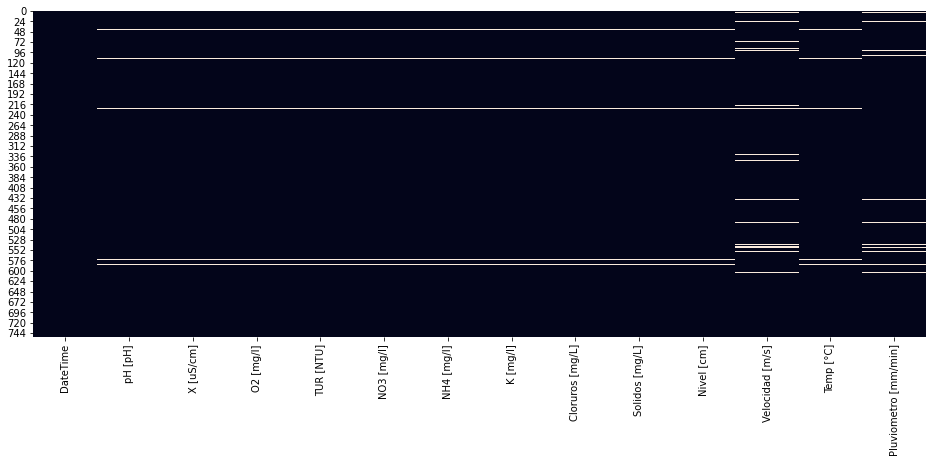

In [37]:
# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_dia.isnull(), cbar=False)

In [38]:
df_dia["Velocidad [m/s]"].value_counts(dropna=False)

0.00    705
NaN      39
0.15      2
0.23      2
0.28      1
0.27      1
0.26      1
0.21      1
0.29      1
Name: Velocidad [m/s], dtype: int64

In [39]:
df_dia["Pluviometro [mm/min]"].value_counts(dropna=False)

0.0    721
NaN     31
1.0      1
Name: Pluviometro [mm/min], dtype: int64

In [40]:
# Eliminamos las filas con missing Values, se elimina todos los las filas NAN son las mismas en todas las columnas 
df_dia.dropna(subset=['pH [pH]'], inplace=True)

In [41]:
columnas_eliminar = ["Velocidad [m/s]", "Pluviometro [mm/min]"]
df_dia = df_dia.drop(columnas_eliminar, axis=1)

<AxesSubplot:>

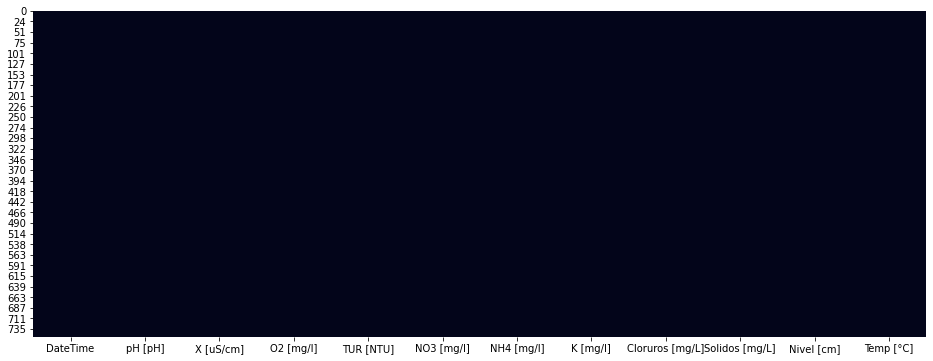

In [42]:
import seaborn as sns

# Identificamos los missing values visualmente
plt.figure(figsize=(16, 6))
sns.heatmap(df_dia.isnull(), cbar=False)

In [43]:
df_dia.reset_index(drop=True, inplace=True)

In [44]:
columns_dia = list(df_dia.columns)
columns_dia = columns_dia[1:]

In [45]:
columns_dia

['pH [pH]',
 'X [uS/cm]',
 'O2 [mg/l]',
 'TUR [NTU]',
 'NO3 [mg/l]',
 'NH4 [mg/l]',
 'K [mg/l]',
 'Cloruros [mg/L]',
 'Solidos [mg/L]',
 'Nivel [cm]',
 'Temp [°C]']

In [46]:
columns_sin_espacios_dia = list()
for i in range(0,len(columns_dia)):
    columnSinEspacios = columns_dia[i].replace(" ", "")
    columnSinEspacios = columnSinEspacios.replace("[", "_")
    columnSinEspacios = columnSinEspacios.replace("]", "")
    columns_sin_espacios_dia.append(columnSinEspacios)

In [47]:
columns_sin_espacios_dia

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

In [48]:
for i in range(len(columns_sin_espacios_dia)):
    df_dia = df_dia.rename(columns={columns_dia[i]: columns_sin_espacios_dia[i]})

In [49]:
df_dia

,DateTime,pH_pH,X_uS/cm,O2_mg/l,TUR_NTU,NO3_mg/l,NH4_mg/l,K_mg/l,Cloruros_mg/L,Solidos_mg/L,Nivel_cm,Temp_°C
0,2023-04-28 12:00:00,7.21,370.58,1.18,52.73,177.50,14.84,21.64,40.38,211.64,221.79,19.03
1,2023-04-28 12:05:00,7.19,367.68,0.90,51.57,171.44,15.01,22.76,38.99,208.63,222.69,18.76
2,2023-04-28 12:10:00,7.18,367.76,0.67,51.02,177.65,15.48,23.96,39.12,207.53,223.95,18.59
3,2023-04-28 12:15:00,7.17,368.73,0.53,50.13,177.01,15.64,24.54,37.61,206.22,227.40,18.46
4,2023-04-28 12:20:00,7.16,364.06,0.40,50.59,185.12,15.66,25.06,38.42,207.19,364.38,18.32
...,...,...,...,...,...,...,...,...,...,...,...,...
733,2023-05-01 05:40:00,7.12,359.81,0.03,55.47,134.15,18.21,41.12,55.85,214.39,420.48,16.90
734,2023-05-01 05:45:00,7.13,358.46,0.03,55.87,133.22,18.15,41.10,55.31,216.96,428.12,16.92
735,2023-05-01 05:50:00,7.13,360.80,0.03,55.81,134.26,18.10,41.22,55.75,216.18,413.43,16.92
736,2023-05-01 05:55:00,7.13,359.26,0.03,55.94,132.04,18.11,41.13,54.95,221.63,384.58,16.89


In [50]:
columns_dia = list(df_dia.columns)
columns_dia = columns_dia[1:]

In [51]:
for column in columns_dia:
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico en el primer subplot
    fig.add_trace(go.Box(y=df_dia[column], name = "Violin"), row=1, col=1)

    # Agregar el segundo gráfico en el segundo subplot
    fig.add_trace(go.Histogram(x=df_dia[column], nbinsx=100, name = "Histograma"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=950, height=400, title="Graficas de violin de "+ column +" para bomba diafragma")

    # Mostrar la figura
    fig.show()


In [52]:
variables_z = list()
for column in columns_dia:
    variable_name = "z_" + column
    globals()[variable_name] = np.abs(stats.zscore(df_dia[column]))
    variables_z.append(variable_name)
variables_z


['z_pH_pH',
 'z_X_uS/cm',
 'z_O2_mg/l',
 'z_TUR_NTU',
 'z_NO3_mg/l',
 'z_NH4_mg/l',
 'z_K_mg/l',
 'z_Cloruros_mg/L',
 'z_Solidos_mg/L',
 'z_Nivel_cm',
 'z_Temp_°C']

In [53]:
variables_atipicos = list()
for i in range(len(columns_dia)):
    variable_name = "atp_" + columns_dia[i] + "_dia"
    globals()[variable_name] = (np.where(globals()[variables_z[i]] > 3))
    variables_atipicos.append(variable_name)
variables_atipicos


['atp_pH_pH_dia',
 'atp_X_uS/cm_dia',
 'atp_O2_mg/l_dia',
 'atp_TUR_NTU_dia',
 'atp_NO3_mg/l_dia',
 'atp_NH4_mg/l_dia',
 'atp_K_mg/l_dia',
 'atp_Cloruros_mg/L_dia',
 'atp_Solidos_mg/L_dia',
 'atp_Nivel_cm_dia',
 'atp_Temp_°C_dia']

In [54]:
atp_Nivel_cm_dia

(array([ 0,  1,  2,  3, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38],
       dtype=int64),)

In [55]:
dataframe_names_dia = list()
# Crear los DataFrames y asignarles nombres de variables
for i in range(len(columns_dia)):
    dataframe_name = f"df_sin_{variables_atipicos[i]}"
    globals()[dataframe_name] = df_dia[[columns_dia[i],"DateTime"]].drop(index = globals()[variables_atipicos[i]][0])
    dataframe_names_dia.append(dataframe_name)
dataframe_names_dia


['df_sin_atp_pH_pH_dia',
 'df_sin_atp_X_uS/cm_dia',
 'df_sin_atp_O2_mg/l_dia',
 'df_sin_atp_TUR_NTU_dia',
 'df_sin_atp_NO3_mg/l_dia',
 'df_sin_atp_NH4_mg/l_dia',
 'df_sin_atp_K_mg/l_dia',
 'df_sin_atp_Cloruros_mg/L_dia',
 'df_sin_atp_Solidos_mg/L_dia',
 'df_sin_atp_Nivel_cm_dia',
 'df_sin_atp_Temp_°C_dia']

In [56]:
for i in range(len(columns_dia)):
    globals()[dataframe_names_dia[i]].reset_index(drop=True, inplace=True)


In [57]:
#globals()[dataframe_names_dia[1]].values

# Comparacion diagrama de violin, con y sin datos atipicos

In [58]:
import plotly.io as pio
for i in range(len(columns_dia)):
    # Crear la figura con dos subplots
    fig = make_subplots(rows=1, cols=2)

    # Agregar el primer gráfico (violin plot) en el primer subplot
    fig.add_trace(go.Violin(y=df_dia[columns_dia[i]], name="sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico (violin plot) en el segundo subplot
    fig.add_trace(go.Violin(y=globals()[dataframe_names_dia[i]].iloc[:, 0], name="con limpieza"), row=1, col=2)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=1000, height=400, title="Gráficas de violín de " + columns_dia[i] + " para bomba diafragma")

    # Mostrar la figura
    fig.show()
    

# Serie de tiempo para PH

In [59]:
for i in range(len(columns_dia)):
    # Crear la figura con subplots
    fig = make_subplots(rows=2, cols=1)

    # Agregar el primer gráfico de líneas en el primer subplot
    fig.add_trace(go.Line(x=df_dia['DateTime'], y=df_dia[columns_dia[i]], name = "Sin limpieza"), row=1, col=1)

    # Agregar el segundo gráfico de líneas en el segundo subplot
    fig.add_trace(go.Line(x=globals()[dataframe_names_dia[i]].iloc[:, 1], y=globals()[dataframe_names_dia[i]].iloc[:, 0], name = "Con limpieza"), row=2, col=1)

    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(height=500, width=1000, title_text="Gráficas de violín de " + columns_dia[i] + " para bomba peristáltica")

    # Mostrar la figura
    fig.show()
    

C:\Users\57314\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




# Modelos de Machine Learning 


Se puede utilizar una serie de tiempo para hacer predicciones de los valores futuros. El análisis de series de tiempo se enfoca en comprender y modelar la estructura temporal de los datos para poder hacer pronósticos.

Hay diferentes métodos y técnicas para realizar predicciones en series de tiempo. Algunas de las técnicas comunes incluyen:

Modelos de promedio móvil (MA): Estos modelos utilizan el promedio de observaciones pasadas para predecir valores futuros. Los modelos MA son útiles para datos que no muestran una tendencia o patrón claro.

Modelos autorregresivos (AR): Estos modelos se basan en regresiones lineales de los valores pasados para predecir los valores futuros. Los modelos AR son útiles para datos que muestran una tendencia o patrón autocorrelacionado.

Modelos ARIMA: Este es un modelo más complejo que combina componentes de los modelos MA y AR para modelar tanto la tendencia como la autocorrelación en los datos.

Modelos de suavizado exponencial: Estos modelos utilizan un promedio ponderado de los valores pasados para predecir los valores futuros. Son útiles cuando hay una tendencia y/o estacionalidad en los datos.

Redes neuronales recurrentes (RNN): Estos modelos son adecuados para capturar patrones complejos en los datos de series de tiempo. Las RNN, como las LSTM (Long Short-Term Memory), son populares para el pronóstico de series de tiempo.

La elección del método de predicción dependerá del tipo de datos, la presencia de tendencias, estacionalidad y otros factores. También es importante realizar una evaluación adecuada del modelo utilizando técnicas de validación y prueba.

En resumen, sí es posible utilizar una serie de tiempo para hacer predicciones de los valores futuros. Sin embargo, la elección del método y la precisión de las predicciones dependerán de la naturaleza de los datos y de la técnica utilizada.

# MODELO DE RNN PH

In [60]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense

In [61]:
X = globals()[dataframe_names[0]].iloc[:,1]
y = globals()[dataframe_names[0]].iloc[:,0]

In [62]:
globals()[dataframe_names[0]].iloc[:,0]

0       7.18
1       7.18
2       7.18
3       7.18
4       7.18
        ... 
6581    7.13
6582    7.13
6583    7.13
6584    7.14
6585    7.14
Name: pH_pH, Length: 6586, dtype: float64

In [63]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train

110    2023-04-01 09:20:00
2576   2023-04-13 01:30:00
2746   2023-04-13 16:40:00
1446   2023-04-08 10:35:00
1867   2023-04-09 22:45:00
               ...        
3772   2023-04-17 10:25:00
5191   2023-04-22 17:35:00
5226   2023-04-22 20:30:00
5390   2023-04-23 11:10:00
860    2023-04-06 07:40:00
Name: DateTime, Length: 5268, dtype: datetime64[ns]

In [64]:
# Reshape de los datos a una matriz 2D
X_train_reshaped = X_train.values.reshape(-1, 1)
X_test_reshaped = X_test.values.reshape(-1, 1)
X_train_reshaped

array([['2023-04-01T09:20:00.000000000'],
       ['2023-04-13T01:30:00.000000000'],
       ['2023-04-13T16:40:00.000000000'],
       ...,
       ['2023-04-22T20:30:00.000000000'],
       ['2023-04-23T11:10:00.000000000'],
       ['2023-04-06T07:40:00.000000000']], dtype='datetime64[ns]')

In [65]:
# Escalar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_reshaped)
X_test_scaled = scaler.transform(X_test_reshaped)
X_train_scaled

array([[0.01440514],
       [0.44681672],
       [0.47022508],
       ...,
       [0.80951768],
       [0.83215434],
       [0.1970418 ]])

In [66]:
# Crear el modelo de RNN
model = Sequential()
model.add(LSTM(10, activation='tanh', input_shape=(1, X_train_scaled.shape[1])))
model.add(Dense(3))

In [67]:
model.compile(loss='mean_squared_error', optimizer='adam')

In [68]:
model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=1)

Epoch 1/30
165/165 [==============================] - 3s 3ms/step - loss: 50.0303
Epoch 2/30
165/165 [==============================] - 0s 2ms/step - loss: 39.5404
Epoch 3/30
165/165 [==============================] - 0s 3ms/step - loss: 22.7089
Epoch 4/30
165/165 [==============================] - 1s 3ms/step - loss: 9.5413
Epoch 5/30
165/165 [==============================] - 1s 3ms/step - loss: 3.4068
Epoch 6/30
165/165 [==============================] - 1s 8ms/step - loss: 1.3654
Epoch 7/30
165/165 [==============================] - 1s 6ms/step - loss: 0.8110
Epoch 8/30
165/165 [==============================] - 1s 5ms/step - loss: 0.6546
Epoch 9/30
165/165 [==============================] - 1s 3ms/step - loss: 0.5851
Epoch 10/30
165/165 [==============================] - 1s 3ms/step - loss: 0.5335
Epoch 11/30
165/165 [==============================] - 0s 2ms/step - loss: 0.4866
Epoch 12/30
165/165 [==============================] - 1s 4ms/step - loss: 0.4418
Epoch 13/30
165/165 [=

In [69]:
loss = model.evaluate(X_test_scaled, y_test)
print("Pérdida en los datos de prueba:", loss)

42/42 [==============================] - 1s 2ms/step - loss: 0.0198
Pérdida en los datos de prueba: 0.01977587305009365


# GRAFICA original y prediccion bomba peristaltica

In [70]:
df_combinado = globals()[dataframe_names[0]][["DateTime", "pH_pH"]]


In [71]:
df_combinado

,DateTime,pH_pH
0,2023-04-01 00:00:00,7.18
1,2023-04-01 00:05:00,7.18
2,2023-04-01 00:10:00,7.18
3,2023-04-01 00:15:00,7.18
4,2023-04-01 00:20:00,7.18
...,...,...
6581,2023-04-27 23:35:00,7.13
6582,2023-04-27 23:40:00,7.13
6583,2023-04-27 23:45:00,7.13
6584,2023-04-27 23:50:00,7.14


In [72]:
df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]

In [73]:
globals()[dataframe_names_dia[0]].iloc[:, 1]

0     2023-04-28 12:05:00
1     2023-04-28 12:10:00
2     2023-04-28 12:15:00
3     2023-04-28 12:20:00
4     2023-04-28 12:25:00
              ...        
732   2023-05-01 05:40:00
733   2023-05-01 05:45:00
734   2023-05-01 05:50:00
735   2023-05-01 05:55:00
736   2023-05-01 06:00:00
Name: DateTime, Length: 737, dtype: datetime64[ns]

In [74]:
X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

In [75]:
predictions = model.predict(X_scaled)

24/24 [==============================] - 1s 3ms/step


In [76]:
predictions

array([[7.052893 , 7.0660243, 6.9997396],
       [7.0538116, 7.066936 , 7.000838 ],
       [7.054727 , 7.0678453, 7.0019336],
       ...,
       [7.256021 , 7.2413907, 7.2905965],
       [7.255812 , 7.241132 , 7.2904625],
       [7.2556024, 7.240873 , 7.290328 ]], dtype=float32)

In [77]:
df_combinado2["pH_pH"] = None
df_combinado2["pH_pH"] = predictions

In [78]:
df_combinado2

,DateTime,pH_pH
0,2023-04-28 12:05:00,7.052893
1,2023-04-28 12:10:00,7.053812
2,2023-04-28 12:15:00,7.054727
3,2023-04-28 12:20:00,7.055641
4,2023-04-28 12:25:00,7.056551
...,...,...
732,2023-05-01 05:40:00,7.256436
733,2023-05-01 05:45:00,7.256229
734,2023-05-01 05:50:00,7.256021
735,2023-05-01 05:55:00,7.255812


In [79]:
df_concatenado = pd.concat([df_combinado, df_combinado2])

In [80]:
df_concatenado.reset_index(drop=True, inplace=True)

In [81]:
# Con model = model
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)


In [82]:
# Calcular las medias móviles utilizando pandas
window_sizes = [100, 200]  # Tamaños de las ventanas de las medias móviles

for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    df_concatenado[column_name] = df_concatenado['pH_pH'].rolling(window=window_size).mean()

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)

# Agregar las líneas de las medias móviles
for window_size in window_sizes:
    column_name = f'Media Móvil {window_size}'
    fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado[column_name], name=f'Media Móvil {window_size}'))

# Actualizar las propiedades de diseño del gráfico
fig.update_layout(title='Gráfico de Línea con Medias Móviles', xaxis_title='Fecha y Hora', yaxis_title='pH_pH')

# Mostrar el gráfico
fig.show()

# Entrenar varios modelos y elegir el mejor

In [83]:
# Lista de parámetros a probar
parametros = [
    {'lstm_units': 50, 'activation': 'tanh'},
    {'lstm_units': 50, 'activation': 'relu'},
    {'lstm_units': 50, 'activation': 'sigmoid'},
    {'lstm_units': 100, 'activation': 'tanh'},
    {'lstm_units': 100, 'activation': 'relu'},
    {'lstm_units': 100, 'activation': 'sigmoid'},
    {'lstm_units': 200, 'activation': 'tanh'},
    {'lstm_units': 200, 'activation': 'relu'},
    {'lstm_units': 200, 'activation': 'sigmoid'}
]
# Variables para almacenar el mejor modelo y su rendimiento
best_model = None
best_loss = float('inf')

In [84]:
# Bucle para entrenar y evaluar los modelos con diferentes parámetros
for params in parametros:
    # Crear el modelo de RNN
    model = Sequential()
    model.add(LSTM(params['lstm_units'], activation=params['activation'], input_shape=(1, X_train_scaled.shape[1])))
    model.add(Dense(3))

    # Compilar el modelo
    model.compile(loss='mean_squared_error', optimizer='adam')

    # Entrenar el modelo
    model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=1)
    
    # Evaluar el modelo en los datos de prueba
    loss = model.evaluate(X_test_scaled, y_test)

    # Comparar la pérdida actual con la mejor pérdida
    if loss < best_loss:
        best_loss = loss
        best_model = model
        

Epoch 1/30
165/165 [==============================] - 3s 3ms/step - loss: 45.1302
Epoch 2/30
165/165 [==============================] - 1s 4ms/step - loss: 14.3000
Epoch 3/30
165/165 [==============================] - 1s 5ms/step - loss: 2.1457
Epoch 4/30
165/165 [==============================] - 0s 3ms/step - loss: 1.4949
Epoch 5/30
165/165 [==============================] - 0s 3ms/step - loss: 1.1211
Epoch 6/30
165/165 [==============================] - 0s 3ms/step - loss: 0.8028
Epoch 7/30
165/165 [==============================] - 0s 3ms/step - loss: 0.5463
Epoch 8/30
165/165 [==============================] - 1s 3ms/step - loss: 0.3518
Epoch 9/30
165/165 [==============================] - 0s 3ms/step - loss: 0.2137
Epoch 10/30
165/165 [==============================] - 0s 3ms/step - loss: 0.1235
Epoch 11/30
165/165 [==============================] - 0s 3ms/step - loss: 0.0700
Epoch 12/30
165/165 [==============================] - 0s 3ms/step - loss: 0.0413
Epoch 13/30
165/165 [==

165/165 [==============================] - 1s 4ms/step - loss: 0.0180
Epoch 16/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0179
Epoch 17/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0180
Epoch 18/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0179
Epoch 19/30
165/165 [==============================] - 1s 4ms/step - loss: 0.0179
Epoch 20/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0179
Epoch 21/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0179
Epoch 22/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0180
Epoch 23/30
165/165 [==============================] - 1s 5ms/step - loss: 0.0179
Epoch 24/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0179
Epoch 25/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0181
Epoch 26/30
165/165 [==============================] - 1s 6ms/step - loss: 0.0179
Epoch 27/30
165/165 [=======

In [85]:
print("Mejor pérdida:", best_loss)


Mejor pérdida: 0.015814118087291718


In [86]:
df_combinado = globals()[dataframe_names[0]][["DateTime", "pH_pH"]]

In [87]:
df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[dataframe_names_dia[0]].iloc[:, 1]

In [88]:
X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

In [89]:
# Utilizar el mejor modelo para hacer predicciones
predictions = best_model.predict(X_scaled)

24/24 [==============================] - 1s 2ms/step


In [90]:
df_combinado2["pH_pH"] = None
df_combinado2["pH_pH"] = predictions

In [91]:
df_concatenado = pd.concat([df_combinado, df_combinado2])

In [92]:
df_concatenado.reset_index(drop=True, inplace=True)

In [93]:
# Con model = model
# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado['pH_pH'], name='Bomba peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia['pH_pH'], name='Bomba de diagragma'))
fig.add_traces(fig2.data)


# Codigo completo Red Neuronal Recurrente

In [94]:
dataframe_names[8]

'df_sin_atp_atp_Solidos_mg/L'

In [95]:
columns

['pH_pH',
 'X_uS/cm',
 'O2_mg/l',
 'TUR_NTU',
 'NO3_mg/l',
 'NH4_mg/l',
 'K_mg/l',
 'Cloruros_mg/L',
 'Solidos_mg/L',
 'Nivel_cm',
 'Temp_°C']

# Red neuronal solidos suspendidos

In [96]:
X = globals()[dataframe_names[8]].iloc[:,1]
y = globals()[dataframe_names[8]].iloc[:,0]

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train

# Reshape de los datos a una matriz 2D
X_train_reshaped = X_train.values.reshape(-1, 1)
X_test_reshaped = X_test.values.reshape(-1, 1)
X_train_reshaped

# Escalar los datos utilizando MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_reshaped)
X_test_scaled = scaler.transform(X_test_reshaped)
X_train_scaled

# Crear el modelo de RNN
model = Sequential()
model.add(LSTM(100, activation='tanh', input_shape=(1, X_train_scaled.shape[1])))
model.add(Dense(3))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=1)

#Calcular la Perdida
loss = model.evaluate(X_test_scaled, y_test)
print("Pérdida en los datos de prueba:", loss)

#Combinar los datos 
df_combinado = globals()[dataframe_names[8]][["DateTime", columns[8]]]
df_combinado2 = pd.DataFrame()
df_combinado2["DateTime"] = globals()[dataframe_names_dia[8]].iloc[:, 1]

X = df_combinado2['DateTime']
X = X.values.reshape(-1, 1)
X_scaled = scaler.fit_transform(X)

predictions = model.predict(X_scaled)

df_combinado2[columns[8]] = None
df_combinado2[columns[8]] = predictions

df_concatenado = pd.concat([df_combinado, df_combinado2])
df_concatenado.reset_index(drop=True, inplace=True)

# Crear el gráfico de línea
fig = go.Figure()
fig2 = go.Figure()

# Agregar la línea de datos originales
fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado[columns[8]], name='Peristaltica + prediccion'))
fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia[columns[8]], name='Diagragma'))
fig.add_traces(fig2.data)
# Actualizar las propiedades de diseño de la figura
fig.update_layout(width=950, height=400, title="Predciciones para  "+ columns[8] +" con Red Neuronal Recurrente")
# Mostrar el gráfico
fig.show()


Epoch 1/30
165/165 [==============================] - 3s 3ms/step - loss: 59073.9844
Epoch 2/30
165/165 [==============================] - 0s 3ms/step - loss: 56290.1250
Epoch 3/30
165/165 [==============================] - 0s 3ms/step - loss: 51038.2734
Epoch 4/30
165/165 [==============================] - 0s 3ms/step - loss: 45649.1055
Epoch 5/30
165/165 [==============================] - 0s 3ms/step - loss: 41131.9531
Epoch 6/30
165/165 [==============================] - 0s 3ms/step - loss: 37535.3984
Epoch 7/30
165/165 [==============================] - 0s 3ms/step - loss: 34750.8516
Epoch 8/30
165/165 [==============================] - 0s 3ms/step - loss: 32617.7832
Epoch 9/30
165/165 [==============================] - 0s 3ms/step - loss: 31007.0938
Epoch 10/30
165/165 [==============================] - 0s 3ms/step - loss: 29803.2246
Epoch 11/30
165/165 [==============================] - 0s 3ms/step - loss: 28911.0840
Epoch 12/30
165/165 [==============================] - 1s 3ms/s

# Todos las variables

## Parametros de oxigenio y solidos suspendidos... Que pueden tener una gran variacion 

In [97]:
def train_and_plot_rnn(i):
    X = globals()[dataframe_names[i]].iloc[:,1]
    y = globals()[dataframe_names[i]].iloc[:,0]

    # Dividir los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    X_train

    # Reshape de los datos a una matriz 2D
    X_train_reshaped = X_train.values.reshape(-1, 1)
    X_test_reshaped = X_test.values.reshape(-1, 1)
    X_train_reshaped

    # Escalar los datos utilizando MinMaxScaler
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train_reshaped)
    X_test_scaled = scaler.transform(X_test_reshaped)
    X_train_scaled

    # Crear el modelo de RNN
    model = Sequential()
    model.add(LSTM(100, activation='sigmoid', input_shape=(1, X_train_scaled.shape[1])))
    model.add(Dense(3))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X_train_scaled, y_train, epochs=30, batch_size=32, verbose=0)

    #Calcular la Perdida
    loss = model.evaluate(X_test_scaled, y_test)
    print("Pérdida en los datos de prueba:", loss)

    #Combinar los datos 
    df_combinado = globals()[dataframe_names[i]][["DateTime", columns[i]]]
    df_combinado2 = pd.DataFrame()
    df_combinado2["DateTime"] = globals()[dataframe_names_dia[i]].iloc[:, 1]

    X = df_combinado2['DateTime']
    X = X.values.reshape(-1, 1)
    X_scaled = scaler.fit_transform(X)

    predictions = model.predict(X_scaled)

    df_combinado2[columns[i]] = None
    df_combinado2[columns[i]] = predictions

    df_concatenado = pd.concat([df_combinado, df_combinado2])
    df_concatenado.reset_index(drop=True, inplace=True)

    # Crear el gráfico de línea
    fig = go.Figure()
    fig2 = go.Figure()

    # Agregar la línea de datos originales
    fig.add_trace(go.Scatter(x=df_concatenado['DateTime'], y=df_concatenado[columns[i]], name='Peristaltica + prediccion'))
    fig2.add_trace(go.Scatter(x=df_dia['DateTime'], y=df_dia[columns[i]], name='Diagragma'))
    fig.add_traces(fig2.data)
    # Actualizar las propiedades de diseño de la figura
    fig.update_layout(width=950, height=400, title="Predicciones para  "+ columns[i] +" con Red Neuronal Recurrente")
    # Mostrar el gráfico
    fig.show()

In [98]:
i = 0
train_and_plot_rnn(i)

42/42 [==============================] - 0s 1ms/step - loss: 0.0164
Pérdida en los datos de prueba: 0.01641385816037655
24/24 [==============================] - 0s 1ms/step


In [99]:
i = 1
train_and_plot_rnn(i)

41/41 [==============================] - 0s 2ms/step - loss: 12355.3174
Pérdida en los datos de prueba: 12355.3173828125
24/24 [==============================] - 0s 3ms/step


In [100]:
i = 2
train_and_plot_rnn(i)

41/41 [==============================] - 1s 4ms/step - loss: 0.1375
Pérdida en los datos de prueba: 0.13746125996112823
23/23 [==============================] - 0s 3ms/step


In [101]:
i = 3
train_and_plot_rnn(i)

41/41 [==============================] - 0s 2ms/step - loss: 1390.0530
Pérdida en los datos de prueba: 1390.052978515625
23/23 [==============================] - 0s 1ms/step


In [102]:
i = 4
train_and_plot_rnn(i)

41/41 [==============================] - 0s 2ms/step - loss: 1445.6022
Pérdida en los datos de prueba: 1445.6021728515625
24/24 [==============================] - 0s 1ms/step


In [103]:
i = 5
train_and_plot_rnn(i)

42/42 [==============================] - 0s 2ms/step - loss: 26.2092
Pérdida en los datos de prueba: 26.209177017211914
23/23 [==============================] - 0s 1ms/step


In [104]:
i = 6
train_and_plot_rnn(i)

42/42 [==============================] - 0s 1ms/step - loss: 32.2556
Pérdida en los datos de prueba: 32.25564193725586
23/23 [==============================] - 0s 4ms/step


In [105]:
i = 7
train_and_plot_rnn(i)

41/41 [==============================] - 0s 2ms/step - loss: 12146.0479
Pérdida en los datos de prueba: 12146.0478515625
24/24 [==============================] - 0s 2ms/step


In [106]:
i = 8
train_and_plot_rnn(i)

42/42 [==============================] - 0s 1ms/step - loss: 28645.3848
Pérdida en los datos de prueba: 28645.384765625
23/23 [==============================] - 0s 1ms/step


In [107]:
i = 9
train_and_plot_rnn(i)

42/42 [==============================] - 0s 2ms/step - loss: 784.0995
Pérdida en los datos de prueba: 784.0994873046875
23/23 [==============================] - 0s 1ms/step


In [108]:
i = 10
train_and_plot_rnn(i)

42/42 [==============================] - 0s 2ms/step - loss: 4.6681
Pérdida en los datos de prueba: 4.6681013107299805
24/24 [==============================] - 0s 1ms/step


# Matriz de correlaciones

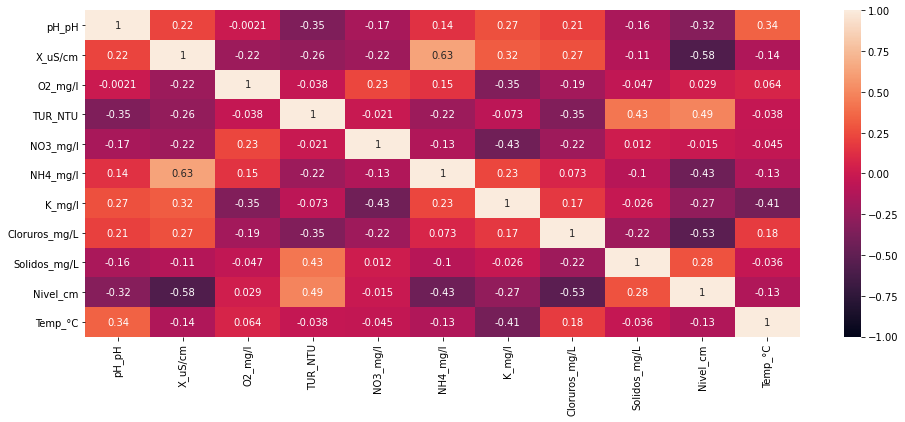

In [97]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(df_per.corr(), vmin=-1, vmax=1, annot=True)


<ipython-input-100-f048e6dcffe6>:3: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



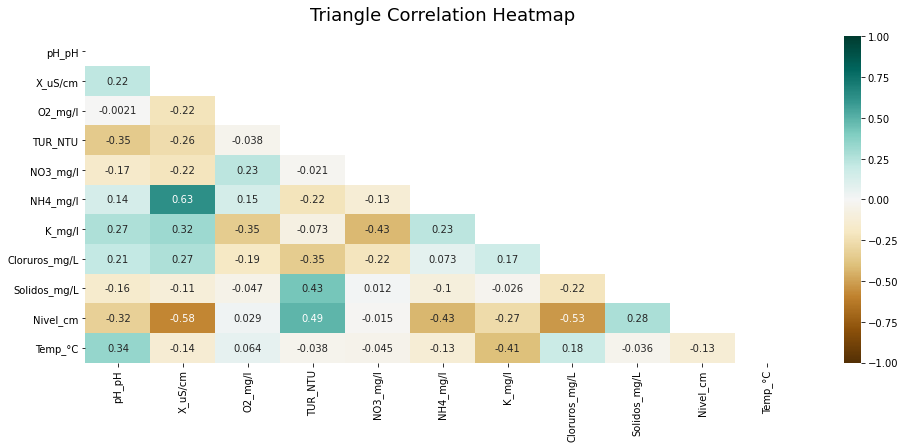

In [100]:
plt.figure(figsize=(16, 6))
# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(df_per.corr(), dtype=np.bool))
heatmap = sns.heatmap(df_per.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize':18}, pad=16);

In [ ]:
plt.figure(figsize=(6, 12))
heatmap = sns.heatmap(df.corr()[['Velocidad del Viento (m/s)']].sort_values(by='Velocidad del Viento (m/s)', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('correlacion de variables con velocidad del viento', fontdict={'fontsize':18}, pad=16);